In [1]:
import os
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
os.environ["KERAS_BACKEND"] = "tensorflow"
import math
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_datasets as tfds
import keras
from keras import layers
from keras import ops

In [3]:
dataset_name = 'my_mushrooms'  # Update this to the actual path of your dataset
dataset_repetitions = 5
num_epochs = 60  # Train for at least 50 epochs for good results
image_size = 64
# KID = Kernel Inception Distance, see related section
kid_image_size = 75
kid_diffusion_steps = 5
plot_diffusion_steps = 20

# Sampling
min_signal_rate = 0.02
max_signal_rate = 0.95

# Architecture
embedding_dims = 32
embedding_max_frequency = 1000.0
widths = [32, 64, 96, 128]
block_depth = 2

# Optimization
batch_size = 64
ema = 0.999
learning_rate = 1e-3
weight_decay = 1e-4

In [4]:
@keras.saving.register_keras_serializable()
class KID(keras.metrics.Metric):
    def __init__(self, name, **kwargs):
        super().__init__(name=name, **kwargs)

        # KID is estimated per batch and is averaged across batches
        self.kid_tracker = keras.metrics.Mean(name="kid_tracker")

        # a pretrained InceptionV3 is used without its classification layer
        # transform the pixel values to the 0-255 range, then use the same
        # preprocessing as during pretraining
        self.encoder = keras.Sequential(
            [
                keras.Input(shape=(image_size, image_size, 3)),
                layers.Rescaling(255.0),
                layers.Resizing(height=kid_image_size, width=kid_image_size),
                layers.Lambda(keras.applications.inception_v3.preprocess_input),
                keras.applications.InceptionV3(
                    include_top=False,
                    input_shape=(kid_image_size, kid_image_size, 3),
                    weights="imagenet",
                ),
                layers.GlobalAveragePooling2D(),
            ],
            name="inception_encoder",
        )

    def polynomial_kernel(self, features_1, features_2):
        feature_dimensions = ops.cast(ops.shape(features_1)[1], dtype="float32")
        return (
            features_1 @ ops.transpose(features_2) / feature_dimensions + 1.0
        ) ** 3.0

    def update_state(self, real_images, generated_images, sample_weight=None):
        real_features = self.encoder(real_images, training=False)
        generated_features = self.encoder(generated_images, training=False)

        # compute polynomial kernels using the two sets of features
        kernel_real = self.polynomial_kernel(real_features, real_features)
        kernel_generated = self.polynomial_kernel(
            generated_features, generated_features
        )
        kernel_cross = self.polynomial_kernel(real_features, generated_features)

        # estimate the squared maximum mean discrepancy using the average kernel values
        batch_size = real_features.shape[0]
        batch_size_f = ops.cast(batch_size, dtype="float32")
        mean_kernel_real = ops.sum(kernel_real * (1.0 - ops.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_generated = ops.sum(
            kernel_generated * (1.0 - ops.eye(batch_size))
        ) / (batch_size_f * (batch_size_f - 1.0))
        mean_kernel_cross = ops.mean(kernel_cross)
        kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

        # update the average KID estimate
        self.kid_tracker.update_state(kid)

    def result(self):
        return self.kid_tracker.result()

    def reset_state(self):
        self.kid_tracker.reset_state()

In [5]:
@keras.saving.register_keras_serializable()
def sinusoidal_embedding(x):
    embedding_min_frequency = 1.0
    frequencies = ops.exp(
        ops.linspace(
            ops.log(embedding_min_frequency),
            ops.log(embedding_max_frequency),
            embedding_dims // 2,
        )
    )
    angular_speeds = ops.cast(2.0 * math.pi * frequencies, "float32")
    embeddings = ops.concatenate(
        [ops.sin(angular_speeds * x), ops.cos(angular_speeds * x)], axis=3
    )
    return embeddings


def ResidualBlock(width):
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same", activation="swish")(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        x = layers.Add()([x, residual])
        return x

    return apply


def DownBlock(width, block_depth):
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            skips.append(x)
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply


def get_network(image_size, widths, block_depth):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))

    e = layers.Lambda(sinusoidal_embedding, output_shape=(1, 1, 32))(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e])

    skips = []
    for width in widths[:-1]:
        x = DownBlock(width, block_depth)([x, skips])

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width in reversed(widths[:-1]):
        x = UpBlock(width, block_depth)([x, skips])

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images, noise_variances], x, name="residual_unet")

In [8]:
@keras.saving.register_keras_serializable()
class DiffusionModel(keras.Model):
    def __init__(self, image_size, widths, block_depth):
        super().__init__()

        self.normalizer = layers.Normalization()
        self.network = get_network(image_size, widths, block_depth)
        self.ema_network = keras.models.clone_model(self.network)

    def compile(self, **kwargs):
        super().compile(**kwargs)

        self.noise_loss_tracker = keras.metrics.Mean(name="n_loss")
        self.image_loss_tracker = keras.metrics.Mean(name="i_loss")
        self.kid = KID(name="kid")

    @property
    def metrics(self):
        return [self.noise_loss_tracker, self.image_loss_tracker, self.kid]

    def denormalize(self, images):
        # convert the pixel values back to 0-1 range
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return ops.clip(images, 0.0, 1.0)

    def diffusion_schedule(self, diffusion_times):
        # diffusion times -> angles
        start_angle = ops.cast(ops.arccos(max_signal_rate), "float32")
        end_angle = ops.cast(ops.arccos(min_signal_rate), "float32")

        diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)

        # angles -> signal and noise rates
        signal_rates = ops.cos(diffusion_angles)
        noise_rates = ops.sin(diffusion_angles)
        # note that their squared sum is always: sin^2(x) + cos^2(x) = 1

        return noise_rates, signal_rates

    def denoise(self, noisy_images, noise_rates, signal_rates, training):
        # the exponential moving average weights are used at evaluation
        if training:
            network = self.network
        else:
            network = self.ema_network

        # predict noise component and calculate the image component using it
        pred_noises = network([noisy_images, noise_rates**2], training=training)
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates

        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps):
        # reverse diffusion = sampling
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps

        # important line:
        # at the first sampling step, the "noisy image" is pure noise
        # but its signal rate is assumed to be nonzero (min_signal_rate)
        next_noisy_images = initial_noise
        for step in range(diffusion_steps):
            noisy_images = next_noisy_images

            # separate the current noisy image to its components
            diffusion_times = ops.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=False
            )
            # network used in eval mode

            # remix the predicted components using the next signal and noise rates
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            next_noisy_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )
            # this new noisy image will be used in the next step

        return pred_images

    def generate(self, num_images, diffusion_steps):
        # noise -> images -> denormalized images
        initial_noise = keras.random.normal(
            shape=(num_images, image_size, image_size, 3)
        )
        generated_images = self.reverse_diffusion(initial_noise, diffusion_steps)
        generated_images = self.denormalize(generated_images)
        return generated_images

    # unique_generate: function  MG added to the diffusion model that isolates the generation feature
    # Input: a set of images to be denoised, number of diffusion steps
    # Output: set of clear images
    def unique_generate(self, initial_noise, diffusion_steps):
        generated_images = self.reverse_diffusion(initial_noise, diffusion_steps)
        return generated_images

    def train_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=True)
        noises = keras.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = keras.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # train the network to separate noisy images to their components
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # used for training
            image_loss = self.loss(images, pred_images)  # only used as metric

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.network.trainable_weights))

        self.noise_loss_tracker.update_state(noise_loss)
        self.image_loss_tracker.update_state(image_loss)

        # track the exponential moving averages of weights
        for weight, ema_weight in zip(self.network.weights, self.ema_network.weights):
            ema_weight.assign(ema * ema_weight + (1 - ema) * weight)

        # KID is not measured during the training phase for computational efficiency
        return {m.name: m.result() for m in self.metrics[:-1]}

    def test_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=False)
        noises = keras.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = keras.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        # use the network to separate noisy images to their components
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )

        noise_loss = self.loss(noises, pred_noises)
        image_loss = self.loss(images, pred_images)

        self.image_loss_tracker.update_state(image_loss)
        self.noise_loss_tracker.update_state(noise_loss)

        # measure KID between real and generated images
        # this is computationally demanding, kid_diffusion_steps has to be small
        images = self.denormalize(images)
        generated_images = self.generate(
            num_images=batch_size, diffusion_steps=kid_diffusion_steps
        )
        self.kid.update_state(images, generated_images)

        return {m.name: m.result() for m in self.metrics}

    def plot_images(self, epoch=None, logs=None, num_rows=3, num_cols=6):
        # plot random generated images for visual evaluation of generation quality
        generated_images = self.generate(
            num_images=num_rows * num_cols,
            diffusion_steps=plot_diffusion_steps,
        )

        plt.figure(figsize=(num_cols * 2.0, num_rows * 2.0))
        for row in range(num_rows):
            for col in range(num_cols):
                index = row * num_cols + col
                plt.subplot(num_rows, num_cols, index + 1)
                plt.imshow(generated_images[index])
                plt.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()

In [9]:
model = DiffusionModel(image_size, widths, block_depth)
# Add in path to model weights file
model.load_weights("drive/MyDrive/diffusion_model.weights.h5")


In [10]:
# All imports necessary for latent stuff
import numpy as np
import tensorflow as tf
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

The following code is set up to perform a latent space analysis on 10 of the generated images. See documentation for further help.

In [12]:
# This function generates our denoised images by generating images one at a time, starting from their noisy state, converting them to a
# numpy array, flattening them into a vector, and then returning it's denoised version.
def generate_image_vectors(image_size, num_images):
    image_vectors = []
    noise_images = []

    for img in range(num_images):
        single_noise = keras.random.normal(shape=(1, image_size, image_size, 3))
        single_noisy_image = single_noise.numpy()
        flat_noisy_image = single_noisy_image.reshape(1, -1)

        image_vectors.append(flat_noisy_image)
        noise_images.append(single_noisy_image[0])

    image_vectors = np.array(image_vectors).reshape(num_images, -1)
    noise_images = np.array(noise_images)
    plt.imshow(noise_images[0])
    plt.show()
    return image_vectors, noise_images

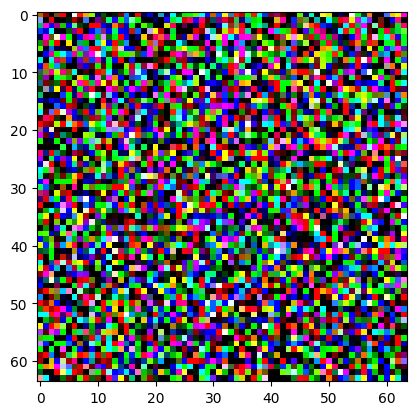

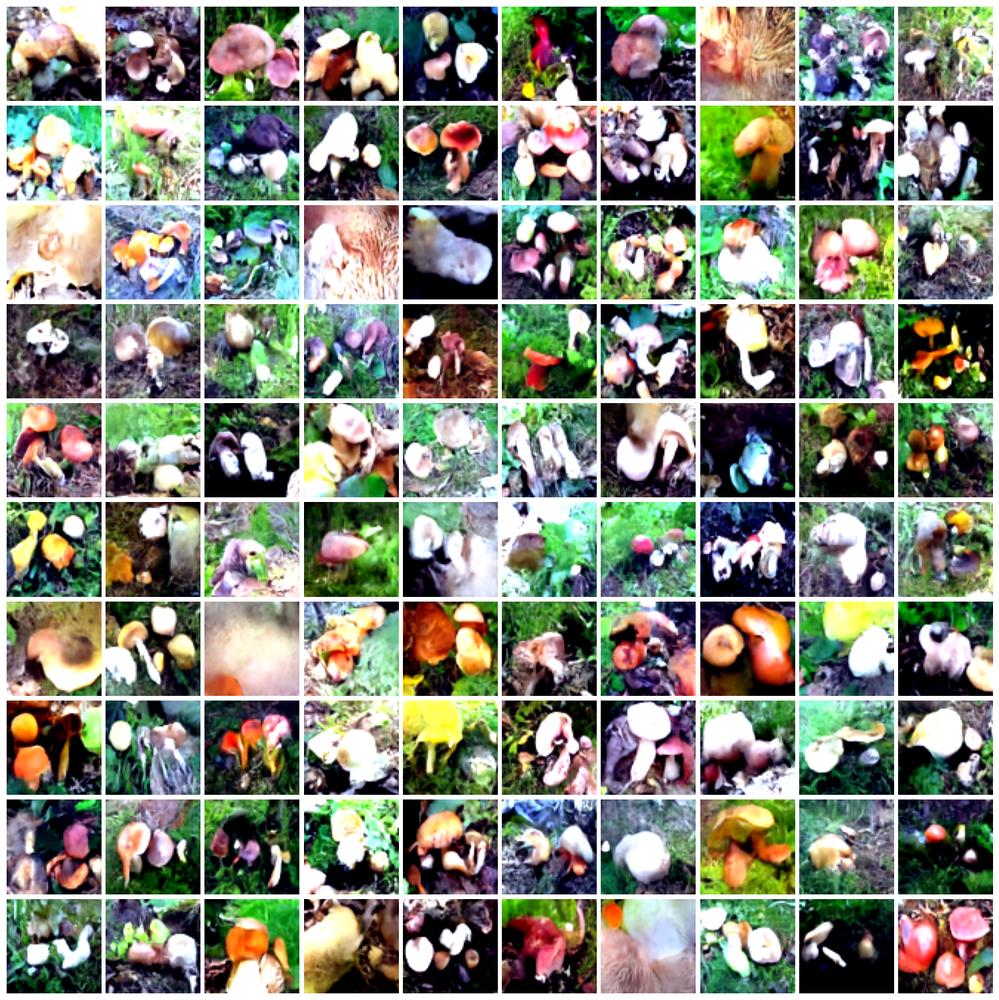

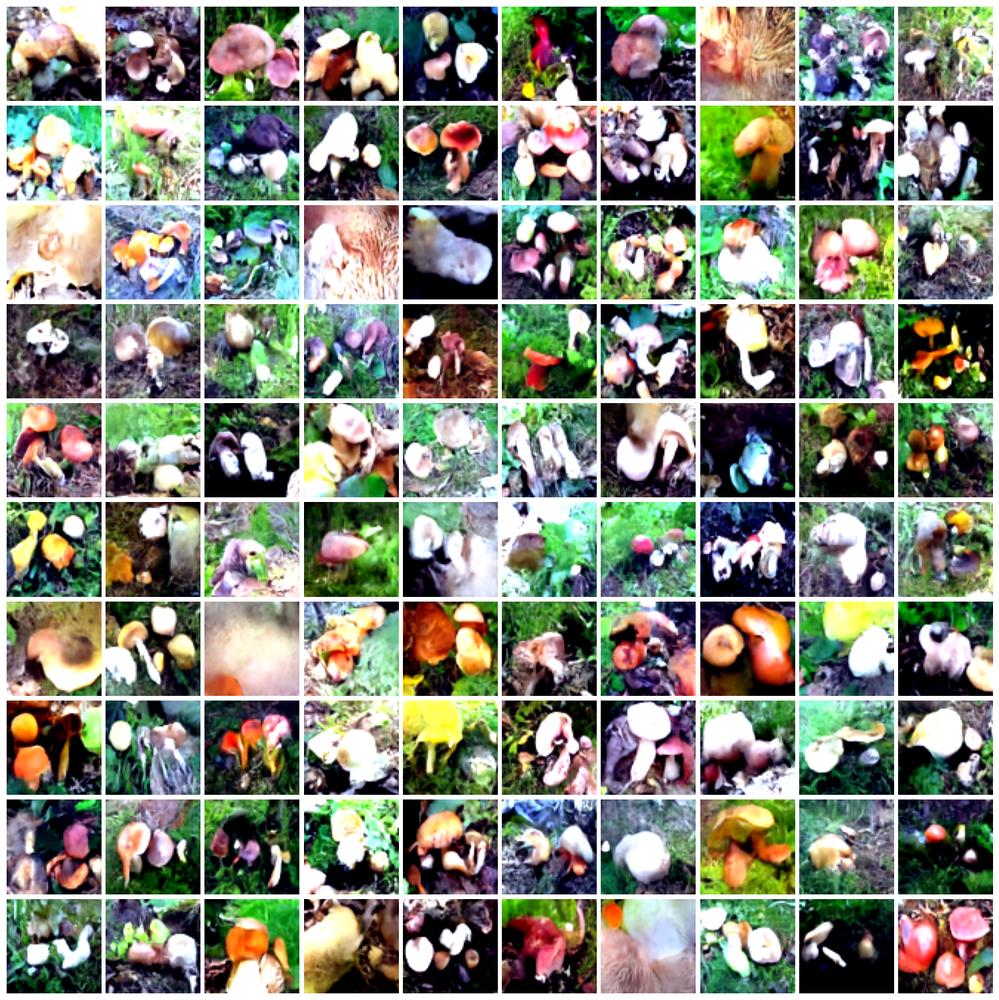

In [14]:
num_images = 100
diffusion_steps = 25

image_vectors, noise_images = generate_image_vectors(64, num_images)
noise_images = noise_images.reshape(-1, 64, 64, 3)
all_denoised = model.unique_generate(tf.convert_to_tensor(noise_images), 25)
all_denoised = all_denoised.numpy()

# Normalize the denoised images
all_denoised = (all_denoised + 1) / 2
# Create a 10x10 grid of subplots
fig, axes = plt.subplots(10, 10, figsize=(15, 15))

for i, ax in enumerate(axes.flat):
    if i < all_denoised.shape[0]:
        ax.imshow(all_denoised[i])
        ax.axis('off')

plt.tight_layout(pad=0.5)
plt.show()

fig, axes = plt.subplots(10, 10, figsize=(15, 15))
for i, ax in enumerate(axes.flat):
    if i < noise_images.shape[0]:
        ax.imshow(all_denoised[i])
        ax.axis('off')

plt.tight_layout(pad=0.5)
plt.show()

In [15]:
# In this function, we standardize our data, performed kmeans ckusering, got our cluster averages, and then allows you to visualize the latent space of the clusters of interest. We specifically
# used this function to visualize the clusters that were "automated" by kmeans, and not handpicked. If you uncomment that code you can see this graph. We have it uncommented just so we can get the
# center clusters of our hand picked clusters without any plots.
def cluster_and_analyze(vectors, n_clusters):
    scaler = StandardScaler()
    scaled_vectors = scaler.fit_transform(vectors)

    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(scaled_vectors)

    cluster_averages = [
        np.mean(vectors[cluster_labels == i], axis=0)
        for i in range(n_clusters)
    ]

    # Visualization
    # plt.figure(figsize=(5, 8))
    # pca = PCA(n_components=10)
    # pca_vectors = pca.fit_transform(scaled_vectors)

    # scatter = plt.scatter(
    #     pca_vectors[:, 0],
    #     pca_vectors[:, 1],
    #     c=cluster_labels,
    #     cmap='viridis'
    # )
    # plt.colorbar(scatter)
    # plt.title(f'Clustering of {len(vectors)} Vectors')
    # plt.show()

    return {
        'cluster_labels': cluster_labels,
        'cluster_centers': kmeans.cluster_centers_,
        'cluster_averages': cluster_averages,
        'inertia': kmeans.inertia_
    }


# results = cluster_and_analyze(image_vectors)

In [16]:
# Here is us defining our red and yellow mushroom clusters, which we observed and chose by hand by indexing specific images.

red_mushrooms = [image_vectors[9], image_vectors[27], image_vectors[40], image_vectors[44], image_vectors[51], image_vectors[56], image_vectors[62], image_vectors[72], image_vectors[85], image_vectors[97]]
yellow_mushrooms = [image_vectors[7], image_vectors[21], image_vectors[22], image_vectors[36], image_vectors[45], image_vectors[46], image_vectors[54], image_vectors[73], image_vectors[79], image_vectors[95]]

In [17]:
# Here is us defining our singular and multiple mushroom clusters, which we observed and chose by hand by indexing specific images.

one_mushroom = [image_vectors[17], image_vectors[26], image_vectors[28], image_vectors[33], image_vectors[37], image_vectors[43], image_vectors[50], image_vectors[55], image_vectors[73], image_vectors[95]]
multiple_mushrooms = [image_vectors[3], image_vectors[8], image_vectors[9], image_vectors[31], image_vectors[46], image_vectors[56], image_vectors[61], image_vectors[68], image_vectors[69], image_vectors[97]]

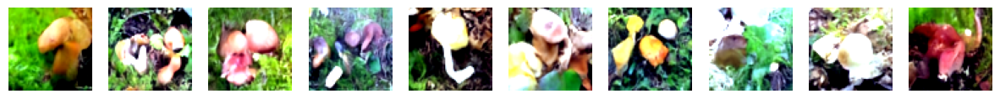

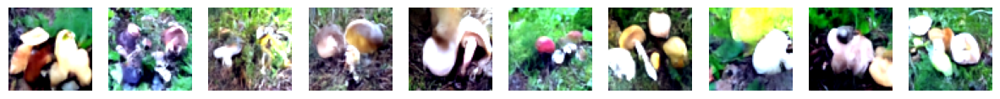

In [19]:
# Indices for red and yellow mushrooms
red_indices = [9, 27, 40, 44, 51, 56, 62, 72, 85, 97]
yellow_indices = [7, 21, 22, 36, 45, 46, 54, 73, 79, 95]

# Indices for singular and multiple mushrooms
one_indices = [17, 26, 28, 33, 37, 43, 50, 55, 73, 95]
multiple_indices = [3, 8, 9, 31, 46, 56, 61, 68, 69, 97]

# Function to plot clusters. These will of course be different images
# than the ones in our blog because our model weights generate 100 different images per run
def plot_mushrooms(indices, images):
    fig, axes = plt.subplots(1, len(indices), figsize=(15, 3))
    fig.patch.set_facecolor('white')
    for i, ax in enumerate(axes):
        if i < len(indices):
            ax.imshow(images[indices[i]])
            ax.axis('off')
    plt.show()

# Plot red mushrooms
# plot_mushrooms(red_indices, all_denoised)

# Plot yellow mushrooms
# plot_mushrooms(yellow_indices, all_denoised)

# Plot singular mushrooms
plot_mushrooms(one_indices, all_denoised)

# Plot multiple mushrooms
plot_mushrooms(multiple_indices, all_denoised)

In [20]:
red_mushrooms = np.array(red_mushrooms)
yellow_mushrooms = np.array(yellow_mushrooms)

one_mushroom = np.array(one_mushroom)
multiple_mushrooms = np.array(multiple_mushrooms)

In [23]:
# In this function, we perform the same operations as cluster_and_analzye but on whatever 2 clusters we've self-defined. It standardizes the data for both clusters,
# performs k mean clustering on them, gets the cluster averages, and visualizes these clusters in a 2D space.
def cluster_and_analyze2(vector1, vector2, n_clusters):
    scaler = StandardScaler()
    scaled_vector1 = scaler.fit_transform(vector1)
    scaled_vector2 = scaler.fit_transform(vector2)

    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels1 = kmeans.fit_predict(scaled_vector1)
    cluster_labels2 = kmeans.fit_predict(scaled_vector2)

    cluster_averages1 = [
        np.mean(vector1[cluster_labels1 == i], axis=0)
        for i in range(n_clusters)
    ]

    cluster_averages2 = [
        np.mean(vector2[cluster_labels2 == i], axis=0)
        for i in range(n_clusters)
    ]

    # Visualization
    plt.figure(figsize=(10, 8))
    plt.style.use('dark_background')

    pca = PCA(n_components=10)
    pca_vectors1 = pca.fit_transform(scaled_vector1)
    pca_vectors2 = pca.fit_transform(scaled_vector2)


    scatter = plt.scatter(
        pca_vectors1[:, 0],
        pca_vectors1[:, 1],
        color = 'red',
        cmap='viridis'
    )

    scatter = plt.scatter(
        pca_vectors2[:, 0],
        pca_vectors2[:, 1],
        color = 'yellow',
        cmap='viridis'
    )


    # Can change the legend to whatever clusters you are representing
    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    plt.legend(['Singular Mushrooms', 'Multiple Mushrooms'])
    plt.title(f'Clustering of Singular vs. Multiple Mushrooms')
    plt.show()


<ipython-input-23-8ff539044c53>:31: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = plt.scatter(
<ipython-input-23-8ff539044c53>:38: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = plt.scatter(


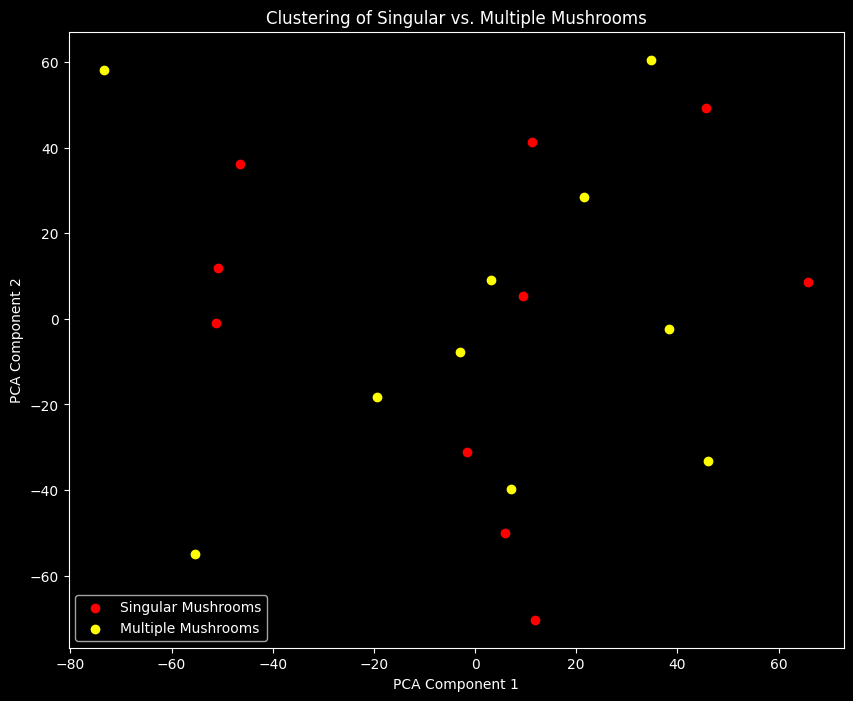

In [24]:
# red_vs_yellow = cluster_and_analyze2(red_mushrooms, yellow_mushrooms, 1)
sing_vs_mult = cluster_and_analyze2(one_mushroom, multiple_mushrooms, 1)

In [25]:
yellow_cluster_centers = cluster_and_analyze(yellow_mushrooms, 1)
red_cluster_centers = cluster_and_analyze(red_mushrooms, 1)

In [26]:
one_cluster_centers = cluster_and_analyze(one_mushroom, 1)
multiple_cluster_centers = cluster_and_analyze(multiple_mushrooms, 1)

In [28]:
def calculate_vector_distance(vector1, vector2):
    return np.array(vector2) - np.array(vector1)

distance1 = calculate_vector_distance(yellow_cluster_centers['cluster_centers'][0], red_cluster_centers['cluster_centers'][0])
distance = calculate_vector_distance(one_cluster_centers['cluster_centers'][0], multiple_cluster_centers['cluster_centers'][0])
print(f'Yellow to Red Mushrooms Distance Vector: \n{distance1}')
# print(f'Singular to Multiple Mushrooms Distance Vector: \n{distance2}')

Yellow to Red Mushrooms Distance Vector: 
[5.3644179e-08 1.7881394e-08 4.7683717e-08 ... 3.5762788e-08 3.5762788e-08
 4.7683717e-08]


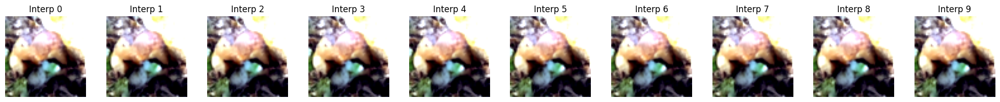

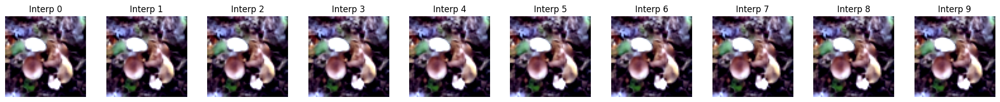

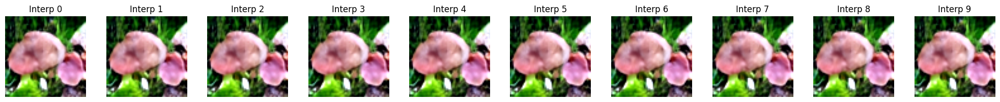

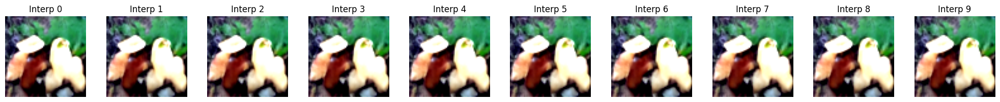

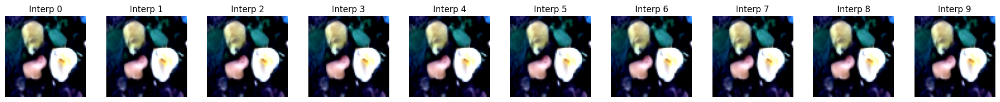

...

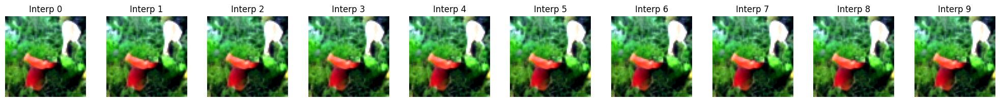

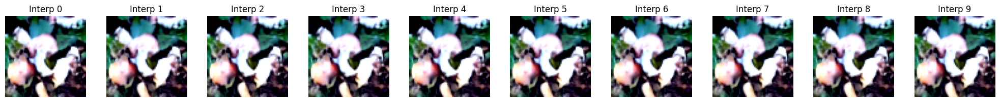

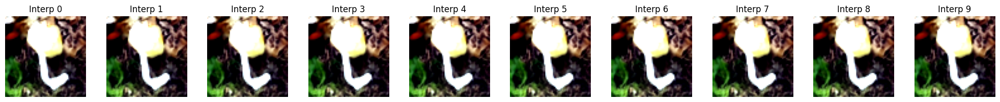

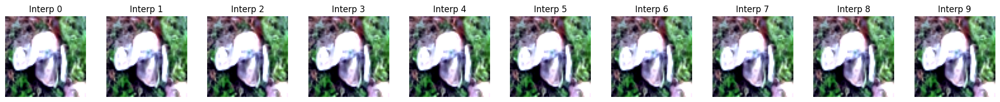

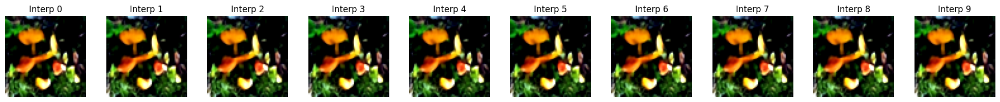

KeyboardInterrupt: 

In [29]:
# This can be used to run an experiment that interpolates between any 2 clusters

interp_steps = 10 # 10 is all that is needed because our space is pretty small
flat_noisy_images = noise_images.reshape(num_images, -1)
pca = PCA(n_components=100)
latent_space = pca.fit_transform(flat_noisy_images)

# Here it generates 100 interpolation experiments. It uses reduced dimension vectors of the interpolations to show the progress from one image to the next after applying the distance vector.
# Since this interpolation occurs in the noisy space, we denoise it to see the observable patterns, if any, in the images.
for i in range(100):
    pca_distance = pca.transform(distance.reshape(1, -1))[0]
    interpolations = np.linspace(latent_space[i], latent_space[i] + pca_distance, interp_steps)

    # Go from reduced dimension vector --> latent vectors --> noisy imagess
    interpolated_noisy_images = np.array([pca.inverse_transform(latent_point).reshape(image_size, image_size, 3)
                                          for latent_point in interpolations])
    denoised_images = model.unique_generate(tf.convert_to_tensor(interpolated_noisy_images, dtype=tf.float32), 25)
    denoised_images = denoised_images.numpy()

    denoised_images = (denoised_images + 1) / 2
    fig, axes = plt.subplots(1, interp_steps, figsize=(interp_steps * 2, 2))  # Single row of plots
    fig.patch.set_facecolor('white')

    for i, denoised_img in enumerate(denoised_images):
        axes[i].imshow(denoised_img)
        axes[i].axis("off")
        axes[i].set_title(f"Interp {i}", color='black')

    plt.tight_layout()
    plt.show()